In [ ]:
import os
os.chdir("/content/drive/MyDrive/MADE/semester3/Advanced_RL")
from pathlib import Path
import random

import numpy as np
import time
from PIL import Image
from mpl_toolkits.axes_grid1 import ImageGrid
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as data
import torchvision.datasets as datasets
import torch.optim as optim
from torch.autograd import Variable
from torchvision.utils import make_grid
import torchvision.transforms as transforms
from tqdm.notebook import trange, tqdm

from matplotlib import pyplot as plt
%load_ext autoreload
%autoreload 2
import dataset
from dataset import *
import model
from model import *


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


#Часть первая: перенос стиля при помощи pix2pix
В этом задании мы будем реализовывать перенос стиля на спаренных данных (paired data). Из стандартных датасетов я выбрал самый маленький -- давайте реализуем перенос стиля из масок сегментации в “настоящие фотографии” для конкретного случая фасадов домов:

Датасет можно скачать здесь (и во многих других местах, должно быть ~29 мегабайт).
В первой части подразумевается реализация pix2pix архитектуры, т.е. генератора и дискриминатора, которые получают на вход условие в виде изображения исходного стиля (подробнее см. лекцию и собственно Isola et al., 2016):   
https://arxiv.org/pdf/1611.07004.pdf


## Скачивам датасеты

In [ ]:
#!curl  http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/facades.tar.gz --output facades.tar.gz
#os.makedirs('data', exist_ok=True)


In [ ]:
#!unzip -q ./facades.tar.gz  

## Датасет

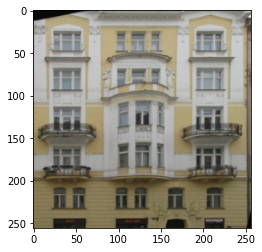

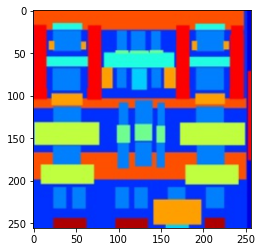

In [ ]:
dataset = Dataset(datapath='./facades/train', split = 'train')
(image, mask) = dataset.__getitem__(20)
im = transforms.ToPILImage()(image).convert("RGB")
plt.imshow(im)
plt.show()

im = transforms.ToPILImage()(mask).convert("RGB")
plt.imshow(im)
plt.show()

In [ ]:
Gen = Generator()
Discr = Discriminator()
Gen.train()
Discr.train()
x = torch.ones((2, 3, 256, 256))
mask = torch.ones((2, 3, 256, 256))
print(Gen(mask).shape)
print(Discr(x, mask).shape)

torch.Size([2, 3, 256, 256])
torch.Size([2, 1, 30, 30])


In [ ]:
batch_size = 16
train_dataset = Dataset('./facades/train', split  = 'train')
test_dataset = Dataset('./facades/val', split = 'val')
train_dataloader = data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=1, drop_last=True)
test_dataloader = data.DataLoader(test_dataset, batch_size=batch_size, shuffle=True, num_workers=1)

lr, beta1, beta2, l1_lambda = 0.0002, 0.5, 0.999, 100
optimizer_G = torch.optim.Adam(Gen.parameters(), lr=lr, betas=(beta1, beta2))
optimizer_D = torch.optim.Adam(Discr.parameters(), lr=lr, betas=(beta1, beta2))

In [ ]:
device = torch.device("cuda") if torch.cuda.is_available() else torch.device('cpu')
Gen.to(device)
Discr.to(device)
print(device)

cuda


In [ ]:
lr, beta1, beta2, l1_lambda = 0.000002, 0.5, 0.999, 100

In [ ]:
num_epochs = 200

for epoch in range(num_epochs):
    print(f'Epoch {epoch + 1}')
    time.sleep(0.5)
    d_losses = []
    g_losses = []
    Gen.train()
    Discr.train()
    for batch in tqdm(train_dataloader):
        images, masks = batch
        #print(images.shape)
        images = images.to(device)
        masks = masks.to(device)
        
        #valid = Variable(torch.Tensor(images.size(0), 1).fill_(1.0), requires_grad=False).to(device)
        #fake = Variable(torch.Tensor(images.size(0), 1).fill_(0.0), requires_grad=False).to(device)
        

        # Generator loss
        optimizer_G.zero_grad()
        generated = Gen(masks)
        disc_generated = Discr(generated, masks)
        valid = Variable(torch.ones((images.size(0), 1, 30, 30)), requires_grad=False).to(device)
        fake = Variable(torch.zeros((images.size(0), 1, 30, 30)), requires_grad=False).to(device)
        
        g_loss = F.binary_cross_entropy(disc_generated, valid) + l1_lambda * F.l1_loss(generated, images)
        g_loss.backward()
        optimizer_G.step()

        # Dicriminator loss
        optimizer_D.zero_grad()
        # Функции потерь на настоящих и фейковых картинках
        real_loss = F.binary_cross_entropy(Discr(images, masks), valid)
        fake_loss = F.binary_cross_entropy(Discr(generated.detach(), masks), fake)
        d_loss = (real_loss + fake_loss) / 2
        d_loss.backward()
        optimizer_D.step()
        
        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())
        
    print(f'g_loss: {np.mean(g_losses)} d_loss: {np.mean(d_losses)}')
    if (epoch + 1) % 10 == 0:
        Gen.eval()
        plot_images(images, masks, generated.detach())

In [ ]:
torch.save(Gen.state_dict(), 'G3.pth')
torch.save(Discr.state_dict(), 'D3.pth')

In [ ]:
Gen.load_state_dict(torch.load('G3.pth'))
Discr.load_state_dict(torch.load('D3.pth'))

<All keys matched successfully>

In [ ]:
test_dataset1 = Dataset('./facades/test', split = 'test')
test_dataloader1 = data.DataLoader(test_dataset1, batch_size=4, shuffle=True, num_workers=2)
dataiter = iter(test_dataloader1)
Gen.eval()


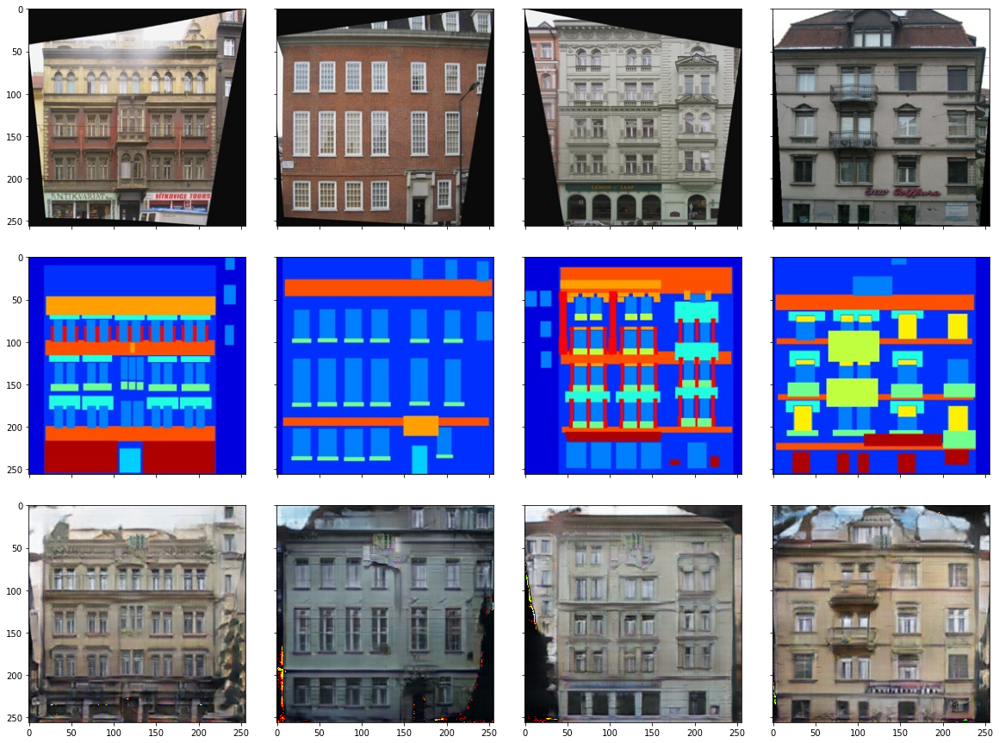

In [ ]:
batch = next(dataiter)
images, masks = batch
images = images.to(device)
masks = masks.to(device)
with torch.no_grad():
    generated = netG(masks)

plot_images(images, masks, generated)

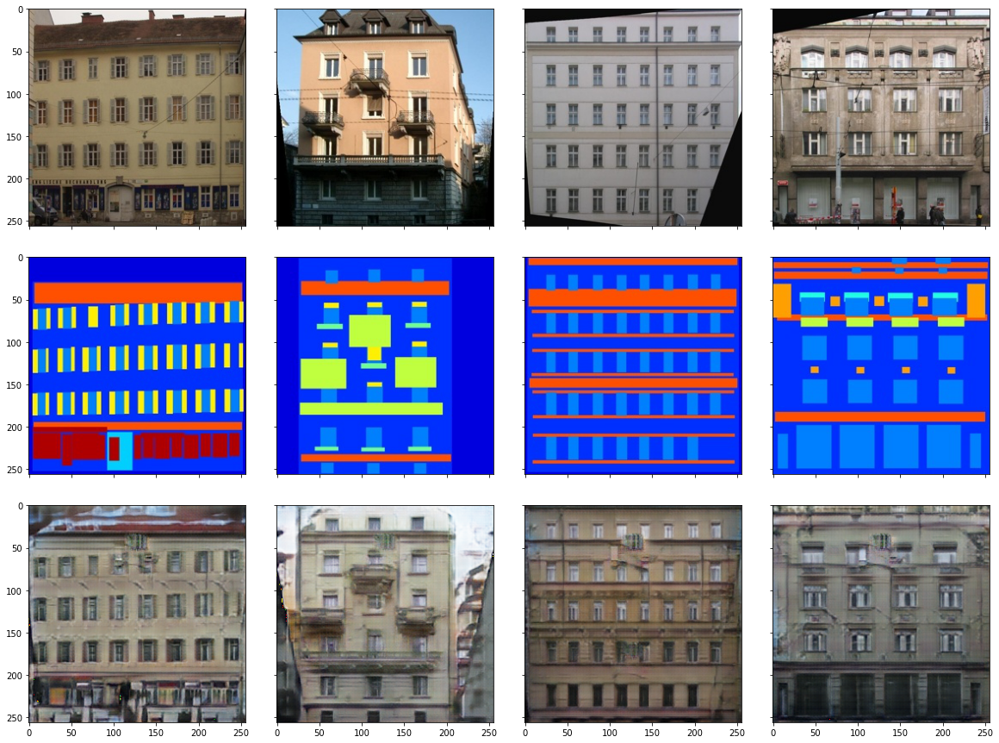

In [ ]:
batch = next(dataiter)
images, masks = batch
images = images.to(device)
masks = masks.to(device)
with torch.no_grad():
    generated = netG(masks)

plot_images(images, masks, generated)

#**Часть вторая: добавим циклы**   
Вторая часть -- реализация CycleGAN. Предлагается на том же датасете реализовать базовую конструкцию CycleGAN для unpaired style transfer, то есть переноса стилей, каждый из которых задан неразмеченным датасетом (подробнее см. лекцию и собственно Zhu et al., 2017):

Безусловный дискриминатор, аналогичный прошлой части и такой же генератор, на основе UNET

In [ ]:
class UnconditionalDiscriminator(nn.Module):
    def __init__(self, mean=0.0, std=0.02):
        super(UnconditionalDiscriminator, self).__init__()
        self.dlist = nn.ModuleList()
        d_input = [3, 64, 128]
        d_output = d_input[1:] + [256]
        for i in range(len(d_input)):
            self.dlist.append(Down_module(d_input[i], d_output[i], batch_norm=(i != 0), mean=mean, std=std))
        self.conv1 = nn.Conv2d(256, 512, kernel_size=(4, 4), padding=1)
        self.conv2 = nn.Conv2d(512, 1, kernel_size=(4, 4), padding=1)
        init_layer(self.conv1, mean, std, True)
        init_layer(self.conv2, mean, std, True)
        self.bn = nn.BatchNorm2d(512)

    def forward(self, x):
        #x = torch.cat([x, masks], 1)
        for block in self.dlist:
            x = block(x)
        # print(x.shape)

        x = self.conv1(x)
        x = self.bn(x)
        x = F.leaky_relu(x, 0.3)
        x = self.conv2(x)

        return torch.sigmoid(x)

In [ ]:
GXY = Generator()
DX = UnconditionalDiscriminator()
GYX = Generator()
DY = UnconditionalDiscriminator()
GXY.train()
DX.train()
GYX.train()
DY.train()
x = torch.ones((2, 3, 256, 256))
mask = torch.ones((2, 3, 256, 256))
print(GX(mask).shape)
print(DX(x).shape)

torch.Size([2, 3, 256, 256])
torch.Size([2, 1, 30, 30])


In [ ]:
batch_size = 1
train_dataset = Dataset('./facades/train', split  = 'train')
test_dataset = Dataset('./facades/val', split = 'val')
train_dataloader = data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=1, drop_last=True)
test_dataloader = data.DataLoader(test_dataset, batch_size=batch_size, shuffle=True, num_workers=1)

l1_lambda  = 10

In [ ]:
device = torch.device("cuda") if torch.cuda.is_available() else torch.device('cpu')
GXY.to(device)
DX.to(device)
DY.to(device)
GYX.to(device)
print(device)

cuda


In [ ]:
GXY.train()
DX.train()
GYX.train()
DY.train()

lr, beta1, beta2, l1_lambda = 0.0002, 0.5, 0.999, 100
optimizer_G = torch.optim.Adam(list(GXY.parameters()) + list(GYX.parameters()), lr=lr, betas=(beta1, beta2))
optimizer_DX  = torch.optim.Adam(DX.parameters(), lr=lr, betas=(beta1, beta2))
optimizer_DY = torch.optim.Adam(DY.parameters(), lr=lr, betas=(beta1, beta2))

Лосс состоит из Cycle consistensy части (результата комбинации преобразований (X->Y) + (Y->X)   и (Y->X) + (X->Y))
и из Adversarial Loss



Epoch 1


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.5215 gxy_loss: 19.6035 dy_loss: 0.2646 dx_loss 0.2569 gy_loss: 0.1009
gx_loss 0.1039 gmask_loss 9.2707  gimage_loss 10.1281
Epoch 2


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4533 gxy_loss: 12.9669 dy_loss: 0.2270 dx_loss 0.2264 gy_loss: 0.1115
gx_loss 0.1119 gmask_loss 5.1156  gimage_loss 7.6279
Epoch 3


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4524 gxy_loss: 10.9721 dy_loss: 0.2260 dx_loss 0.2264 gy_loss: 0.1113
gx_loss 0.1113 gmask_loss 4.3966  gimage_loss 6.3529
Epoch 4


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4499 gxy_loss: 9.1823 dy_loss: 0.2251 dx_loss 0.2247 gy_loss: 0.1115
gx_loss 0.1115 gmask_loss 3.8604  gimage_loss 5.0989
Epoch 5


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4504 gxy_loss: 8.0664 dy_loss: 0.2252 dx_loss 0.2252 gy_loss: 0.1115
gx_loss 0.1114 gmask_loss 3.5383  gimage_loss 4.3051


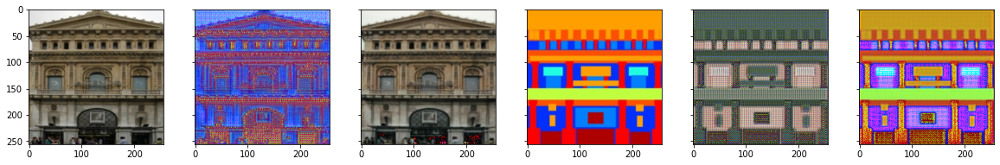

Epoch 6


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4487 gxy_loss: 7.2811 dy_loss: 0.2241 dx_loss 0.2246 gy_loss: 0.1114
gx_loss 0.1115 gmask_loss 3.2102  gimage_loss 3.8481
Epoch 7


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4489 gxy_loss: 6.7744 dy_loss: 0.2243 dx_loss 0.2246 gy_loss: 0.1114
gx_loss 0.1113 gmask_loss 2.9943  gimage_loss 3.5574
Epoch 8


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4496 gxy_loss: 6.3647 dy_loss: 0.2246 dx_loss 0.2249 gy_loss: 0.1113
gx_loss 0.1111 gmask_loss 2.7938  gimage_loss 3.3484
Epoch 9


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4705 gxy_loss: 6.1183 dy_loss: 0.2454 dx_loss 0.2251 gy_loss: 0.1011
gx_loss 0.1113 gmask_loss 2.7136  gimage_loss 3.1923
Epoch 10


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4472 gxy_loss: 5.8590 dy_loss: 0.2237 dx_loss 0.2235 gy_loss: 0.1114
gx_loss 0.1113 gmask_loss 2.5656  gimage_loss 3.0706


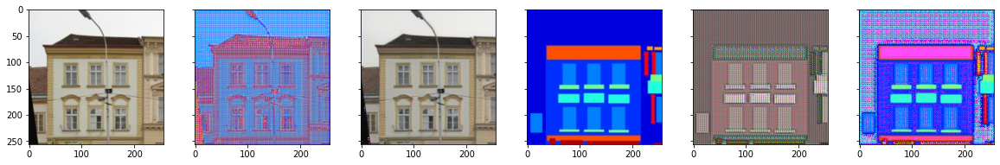

Epoch 11


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4518 gxy_loss: 5.6012 dy_loss: 0.2241 dx_loss 0.2277 gy_loss: 0.1114
gx_loss 0.1100 gmask_loss 2.4429  gimage_loss 2.9369
Epoch 12


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4474 gxy_loss: 5.4387 dy_loss: 0.2238 dx_loss 0.2236 gy_loss: 0.1112
gx_loss 0.1114 gmask_loss 2.3805  gimage_loss 2.8356
Epoch 13


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4493 gxy_loss: 5.2912 dy_loss: 0.2260 dx_loss 0.2233 gy_loss: 0.1105
gx_loss 0.1113 gmask_loss 2.3642  gimage_loss 2.7053
Epoch 14


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4476 gxy_loss: 5.1947 dy_loss: 0.2238 dx_loss 0.2239 gy_loss: 0.1112
gx_loss 0.1112 gmask_loss 2.3008  gimage_loss 2.6714
Epoch 15


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4488 gxy_loss: 5.0415 dy_loss: 0.2242 dx_loss 0.2245 gy_loss: 0.1113
gx_loss 0.1111 gmask_loss 2.2355  gimage_loss 2.5837


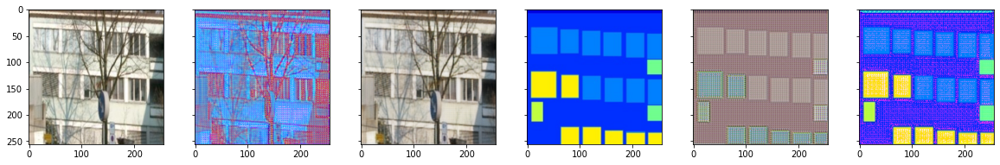

Epoch 16


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4476 gxy_loss: 4.9202 dy_loss: 0.2234 dx_loss 0.2242 gy_loss: 0.1111
gx_loss 0.1110 gmask_loss 2.1724  gimage_loss 2.5258
Epoch 17


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4564 gxy_loss: 4.8149 dy_loss: 0.2239 dx_loss 0.2324 gy_loss: 0.1111
gx_loss 0.1079 gmask_loss 2.1272  gimage_loss 2.4686
Epoch 18


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4485 gxy_loss: 4.6788 dy_loss: 0.2242 dx_loss 0.2243 gy_loss: 0.1112
gx_loss 0.1111 gmask_loss 2.0995  gimage_loss 2.3570
Epoch 19


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4497 gxy_loss: 4.5776 dy_loss: 0.2265 dx_loss 0.2232 gy_loss: 0.1099
gx_loss 0.1112 gmask_loss 2.0354  gimage_loss 2.3211
Epoch 20


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4475 gxy_loss: 4.4642 dy_loss: 0.2238 dx_loss 0.2237 gy_loss: 0.1111
gx_loss 0.1112 gmask_loss 1.9885  gimage_loss 2.2534


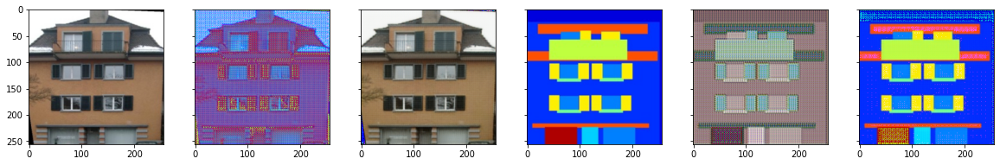

Epoch 21


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4470 gxy_loss: 4.3978 dy_loss: 0.2234 dx_loss 0.2236 gy_loss: 0.1111
gx_loss 0.1110 gmask_loss 1.9786  gimage_loss 2.1971
Epoch 22


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4468 gxy_loss: 4.3194 dy_loss: 0.2236 dx_loss 0.2232 gy_loss: 0.1112
gx_loss 0.1112 gmask_loss 1.9104  gimage_loss 2.1866
Epoch 23


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4478 gxy_loss: 4.2758 dy_loss: 0.2244 dx_loss 0.2235 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.9099  gimage_loss 2.1438
Epoch 24


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4466 gxy_loss: 4.1541 dy_loss: 0.2233 dx_loss 0.2233 gy_loss: 0.1110
gx_loss 0.1111 gmask_loss 1.8444  gimage_loss 2.0876
Epoch 25


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4462 gxy_loss: 4.0851 dy_loss: 0.2235 dx_loss 0.2227 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.8202  gimage_loss 2.0426


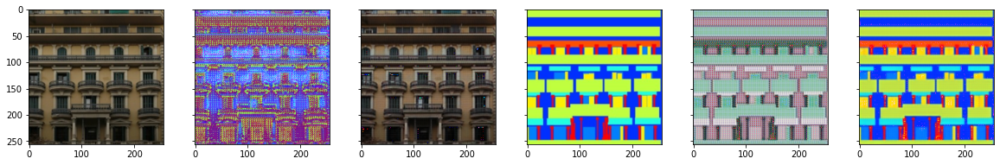

Epoch 26


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4463 gxy_loss: 4.0713 dy_loss: 0.2237 dx_loss 0.2226 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.8247  gimage_loss 2.0245
Epoch 27


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4460 gxy_loss: 4.0131 dy_loss: 0.2236 dx_loss 0.2224 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.7931  gimage_loss 1.9978
Epoch 28


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4458 gxy_loss: 3.8822 dy_loss: 0.2232 dx_loss 0.2225 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.7550  gimage_loss 1.9051
Epoch 29


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4488 gxy_loss: 3.8726 dy_loss: 0.2234 dx_loss 0.2254 gy_loss: 0.1111
gx_loss 0.1100 gmask_loss 1.7241  gimage_loss 1.9274
Epoch 30


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4466 gxy_loss: 3.8521 dy_loss: 0.2239 dx_loss 0.2227 gy_loss: 0.1109
gx_loss 0.1111 gmask_loss 1.7285  gimage_loss 1.9017


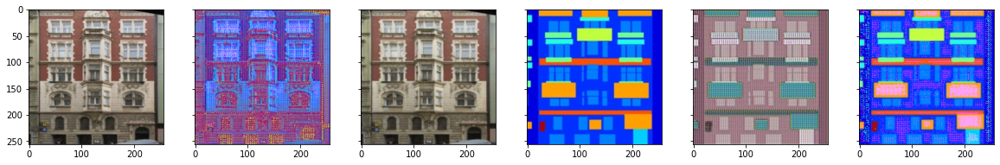

Epoch 31


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4463 gxy_loss: 3.7849 dy_loss: 0.2238 dx_loss 0.2225 gy_loss: 0.1109
gx_loss 0.1111 gmask_loss 1.7039  gimage_loss 1.8590
Epoch 32


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4454 gxy_loss: 3.7129 dy_loss: 0.2229 dx_loss 0.2225 gy_loss: 0.1112
gx_loss 0.1111 gmask_loss 1.6400  gimage_loss 1.8506
Epoch 33


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4462 gxy_loss: 3.6838 dy_loss: 0.2237 dx_loss 0.2225 gy_loss: 0.1110
gx_loss 0.1111 gmask_loss 1.6408  gimage_loss 1.8209
Epoch 34


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4458 gxy_loss: 3.7902 dy_loss: 0.2233 dx_loss 0.2225 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.7415  gimage_loss 1.8265
Epoch 35


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4455 gxy_loss: 3.5807 dy_loss: 0.2230 dx_loss 0.2225 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.6140  gimage_loss 1.7445


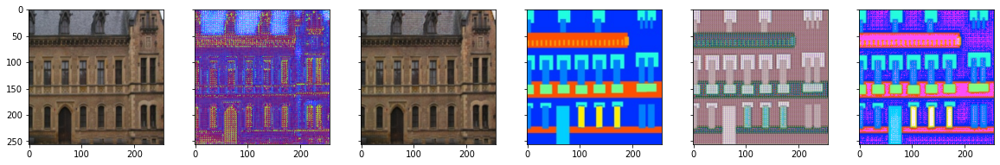

Epoch 36


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4461 gxy_loss: 3.5748 dy_loss: 0.2235 dx_loss 0.2225 gy_loss: 0.1109
gx_loss 0.1111 gmask_loss 1.5899  gimage_loss 1.7629
Epoch 37


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4459 gxy_loss: 3.4474 dy_loss: 0.2234 dx_loss 0.2225 gy_loss: 0.1110
gx_loss 0.1111 gmask_loss 1.5511  gimage_loss 1.6741
Epoch 38


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4462 gxy_loss: 3.6051 dy_loss: 0.2236 dx_loss 0.2225 gy_loss: 0.1110
gx_loss 0.1111 gmask_loss 1.6699  gimage_loss 1.7131
Epoch 39


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4457 gxy_loss: 3.4857 dy_loss: 0.2232 dx_loss 0.2225 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.5675  gimage_loss 1.6959
Epoch 40


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4454 gxy_loss: 3.3990 dy_loss: 0.2230 dx_loss 0.2225 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.5263  gimage_loss 1.6505


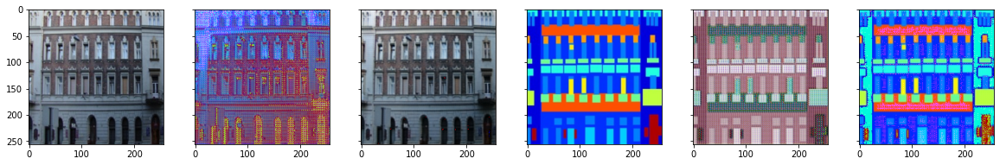

Epoch 41


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4454 gxy_loss: 3.3903 dy_loss: 0.2229 dx_loss 0.2225 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.5139  gimage_loss 1.6542
Epoch 42


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4459 gxy_loss: 3.3758 dy_loss: 0.2235 dx_loss 0.2225 gy_loss: 0.1110
gx_loss 0.1111 gmask_loss 1.5163  gimage_loss 1.6373
Epoch 43


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4452 gxy_loss: 3.4163 dy_loss: 0.2228 dx_loss 0.2225 gy_loss: 0.1112
gx_loss 0.1111 gmask_loss 1.5725  gimage_loss 1.6215
Epoch 44


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4469 gxy_loss: 3.2885 dy_loss: 0.2234 dx_loss 0.2235 gy_loss: 0.1109
gx_loss 0.1108 gmask_loss 1.4878  gimage_loss 1.5790
Epoch 45


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4452 gxy_loss: 3.2292 dy_loss: 0.2228 dx_loss 0.2223 gy_loss: 0.1112
gx_loss 0.1111 gmask_loss 1.4609  gimage_loss 1.5460


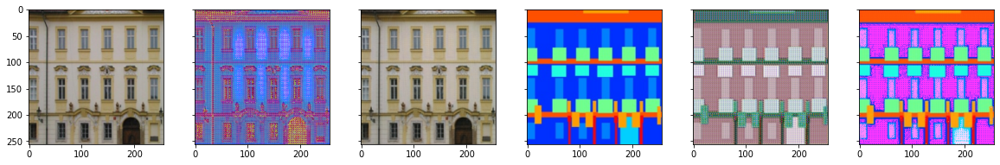

Epoch 46


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4467 gxy_loss: 3.2216 dy_loss: 0.2242 dx_loss 0.2224 gy_loss: 0.1106
gx_loss 0.1111 gmask_loss 1.4628  gimage_loss 1.5371
Epoch 47


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4455 gxy_loss: 3.1887 dy_loss: 0.2231 dx_loss 0.2224 gy_loss: 0.1110
gx_loss 0.1111 gmask_loss 1.4307  gimage_loss 1.5358
Epoch 48


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4454 gxy_loss: 3.1515 dy_loss: 0.2230 dx_loss 0.2224 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.4206  gimage_loss 1.5087
Epoch 49


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4452 gxy_loss: 3.1374 dy_loss: 0.2228 dx_loss 0.2224 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.4182  gimage_loss 1.4970
Epoch 50


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4453 gxy_loss: 3.1072 dy_loss: 0.2229 dx_loss 0.2224 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.4190  gimage_loss 1.4660


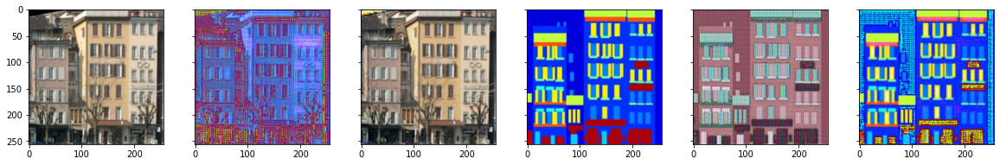

Epoch 51


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4452 gxy_loss: 3.1269 dy_loss: 0.2228 dx_loss 0.2224 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.4438  gimage_loss 1.4610
Epoch 52


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4454 gxy_loss: 3.1407 dy_loss: 0.2230 dx_loss 0.2224 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.4090  gimage_loss 1.5095
Epoch 53


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4453 gxy_loss: 3.0778 dy_loss: 0.2229 dx_loss 0.2224 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.3995  gimage_loss 1.4560
Epoch 54


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4453 gxy_loss: 2.9908 dy_loss: 0.2229 dx_loss 0.2224 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.3377  gimage_loss 1.4310
Epoch 55


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4454 gxy_loss: 3.0220 dy_loss: 0.2230 dx_loss 0.2224 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.3485  gimage_loss 1.4514


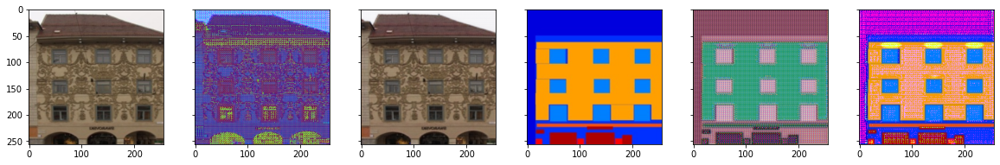

Epoch 56


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4453 gxy_loss: 2.9534 dy_loss: 0.2229 dx_loss 0.2224 gy_loss: 0.1110
gx_loss 0.1111 gmask_loss 1.3303  gimage_loss 1.4010
Epoch 57


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4456 gxy_loss: 2.9619 dy_loss: 0.2232 dx_loss 0.2224 gy_loss: 0.1110
gx_loss 0.1111 gmask_loss 1.3392  gimage_loss 1.4006
Epoch 58


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4452 gxy_loss: 2.9025 dy_loss: 0.2228 dx_loss 0.2224 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.3203  gimage_loss 1.3601
Epoch 59


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4452 gxy_loss: 2.9071 dy_loss: 0.2228 dx_loss 0.2224 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.3230  gimage_loss 1.3620
Epoch 60


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4452 gxy_loss: 2.9048 dy_loss: 0.2228 dx_loss 0.2224 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.3263  gimage_loss 1.3563


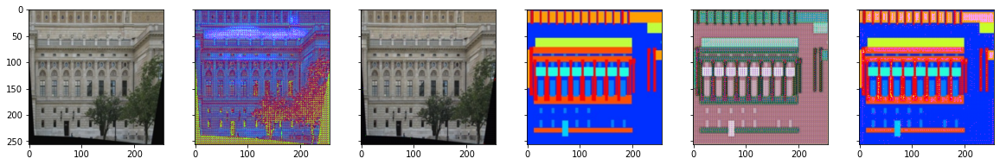

Epoch 61


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4455 gxy_loss: 2.8889 dy_loss: 0.2231 dx_loss 0.2224 gy_loss: 0.1110
gx_loss 0.1111 gmask_loss 1.3145  gimage_loss 1.3523
Epoch 62


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4453 gxy_loss: 2.8529 dy_loss: 0.2229 dx_loss 0.2224 gy_loss: 0.1110
gx_loss 0.1111 gmask_loss 1.2908  gimage_loss 1.3399
Epoch 63


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4449 gxy_loss: 2.8231 dy_loss: 0.2225 dx_loss 0.2224 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.2866  gimage_loss 1.3143
Epoch 64


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4454 gxy_loss: 2.8311 dy_loss: 0.2231 dx_loss 0.2224 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.2850  gimage_loss 1.3239
Epoch 65


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4459 gxy_loss: 2.7960 dy_loss: 0.2235 dx_loss 0.2224 gy_loss: 0.1108
gx_loss 0.1111 gmask_loss 1.2650  gimage_loss 1.3091


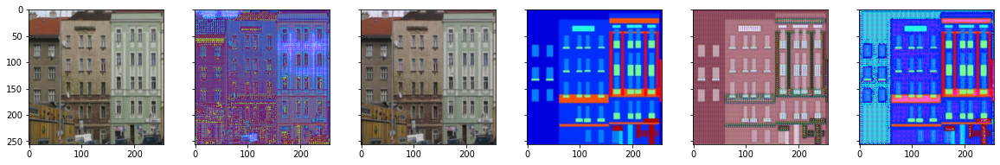

Epoch 66


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4451 gxy_loss: 2.7547 dy_loss: 0.2228 dx_loss 0.2224 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.2390  gimage_loss 1.2935
Epoch 67


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4452 gxy_loss: 2.7370 dy_loss: 0.2228 dx_loss 0.2224 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.2327  gimage_loss 1.2821
Epoch 68


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4453 gxy_loss: 2.7180 dy_loss: 0.2229 dx_loss 0.2224 gy_loss: 0.1110
gx_loss 0.1111 gmask_loss 1.2248  gimage_loss 1.2710
Epoch 69


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4452 gxy_loss: 2.7459 dy_loss: 0.2228 dx_loss 0.2224 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.2473  gimage_loss 1.2765
Epoch 70


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4449 gxy_loss: 2.6911 dy_loss: 0.2225 dx_loss 0.2224 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.2310  gimage_loss 1.2379


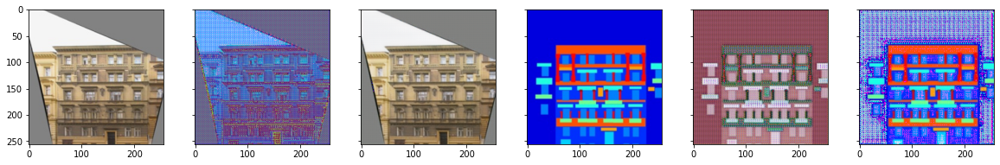

Epoch 71


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4458 gxy_loss: 2.6717 dy_loss: 0.2226 dx_loss 0.2233 gy_loss: 0.1111
gx_loss 0.1109 gmask_loss 1.2086  gimage_loss 1.2411
Epoch 72


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4450 gxy_loss: 2.6999 dy_loss: 0.2227 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.2234  gimage_loss 1.2543
Epoch 73


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4460 gxy_loss: 2.7720 dy_loss: 0.2237 dx_loss 0.2223 gy_loss: 0.1107
gx_loss 0.1111 gmask_loss 1.2909  gimage_loss 1.2593
Epoch 74


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4460 gxy_loss: 2.6620 dy_loss: 0.2237 dx_loss 0.2223 gy_loss: 0.1109
gx_loss 0.1111 gmask_loss 1.2183  gimage_loss 1.2217
Epoch 75


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4450 gxy_loss: 2.6048 dy_loss: 0.2227 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.1965  gimage_loss 1.1861


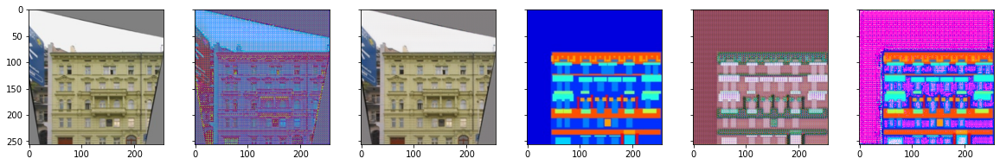

Epoch 76


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4448 gxy_loss: 2.5907 dy_loss: 0.2225 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.1718  gimage_loss 1.1966
Epoch 77


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4449 gxy_loss: 2.5698 dy_loss: 0.2226 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.1499  gimage_loss 1.1977
Epoch 78


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4452 gxy_loss: 2.5805 dy_loss: 0.2229 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.1717  gimage_loss 1.1866
Epoch 79


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4449 gxy_loss: 2.5490 dy_loss: 0.2226 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.1589  gimage_loss 1.1679
Epoch 80


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4448 gxy_loss: 2.5708 dy_loss: 0.2225 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.1596  gimage_loss 1.1890


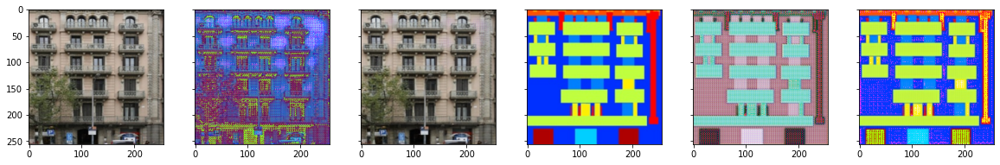

Epoch 81


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4450 gxy_loss: 2.5346 dy_loss: 0.2227 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.1501  gimage_loss 1.1624
Epoch 82


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4449 gxy_loss: 2.5655 dy_loss: 0.2225 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.1752  gimage_loss 1.1680
Epoch 83


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4448 gxy_loss: 2.5204 dy_loss: 0.2225 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.1479  gimage_loss 1.1504
Epoch 84


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4449 gxy_loss: 2.4683 dy_loss: 0.2225 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.1083  gimage_loss 1.1377
Epoch 85


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4448 gxy_loss: 2.6424 dy_loss: 0.2225 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.2292  gimage_loss 1.1910


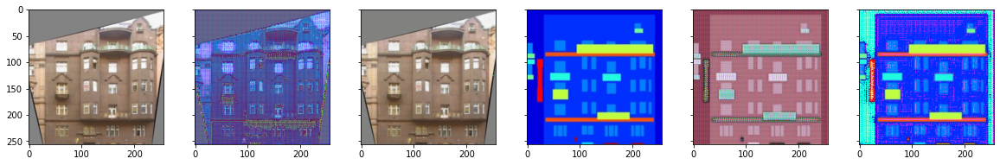

Epoch 86


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4448 gxy_loss: 2.5294 dy_loss: 0.2225 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.1679  gimage_loss 1.1393
Epoch 87


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4449 gxy_loss: 2.4692 dy_loss: 0.2225 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.1120  gimage_loss 1.1350
Epoch 88


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4447 gxy_loss: 2.4596 dy_loss: 0.2224 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.1087  gimage_loss 1.1287
Epoch 89


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4449 gxy_loss: 2.4235 dy_loss: 0.2226 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.0924  gimage_loss 1.1088
Epoch 90


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4451 gxy_loss: 2.4133 dy_loss: 0.2228 dx_loss 0.2223 gy_loss: 0.1110
gx_loss 0.1111 gmask_loss 1.0922  gimage_loss 1.0989


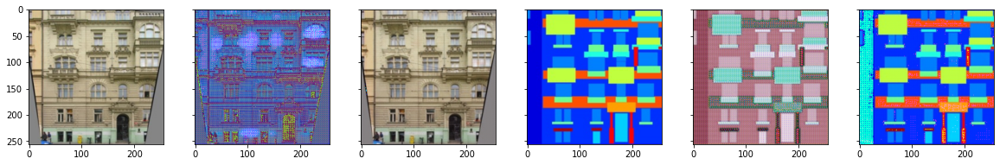

Epoch 91


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4447 gxy_loss: 2.4104 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.0852  gimage_loss 1.1030
Epoch 92


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4448 gxy_loss: 2.4182 dy_loss: 0.2225 dx_loss 0.2224 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.0972  gimage_loss 1.0988
Epoch 93


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4448 gxy_loss: 2.3961 dy_loss: 0.2225 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.0820  gimage_loss 1.0918
Epoch 94


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4448 gxy_loss: 2.3723 dy_loss: 0.2225 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.0720  gimage_loss 1.0781
Epoch 95


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4449 gxy_loss: 2.3455 dy_loss: 0.2226 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.0505  gimage_loss 1.0728


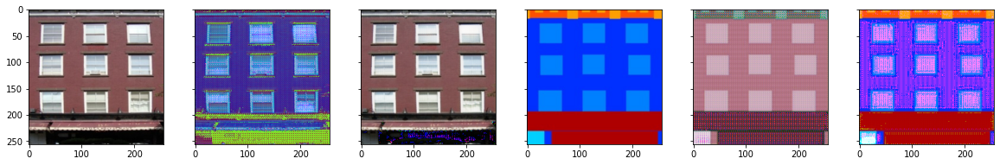

Epoch 96


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 2.4678 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.1648  gimage_loss 1.0808
Epoch 97


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4447 gxy_loss: 2.3728 dy_loss: 0.2224 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.0752  gimage_loss 1.0754
Epoch 98


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4447 gxy_loss: 2.2879 dy_loss: 0.2224 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.0342  gimage_loss 1.0315
Epoch 99


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4447 gxy_loss: 2.3379 dy_loss: 0.2224 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.0483  gimage_loss 1.0674
Epoch 100


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4447 gxy_loss: 2.2989 dy_loss: 0.2224 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.0343  gimage_loss 1.0424


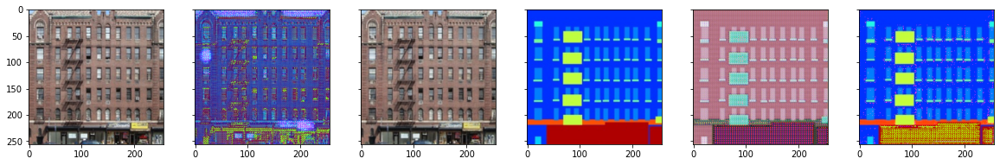

Epoch 101


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4447 gxy_loss: 2.3170 dy_loss: 0.2224 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.0414  gimage_loss 1.0534
Epoch 102


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4447 gxy_loss: 2.2818 dy_loss: 0.2224 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.0253  gimage_loss 1.0343
Epoch 103


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4455 gxy_loss: 2.2817 dy_loss: 0.2232 dx_loss 0.2223 gy_loss: 0.1109
gx_loss 0.1111 gmask_loss 1.0242  gimage_loss 1.0355
Epoch 104


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 2.2440 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.0093  gimage_loss 1.0124
Epoch 105


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 2.2860 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.0296  gimage_loss 1.0342


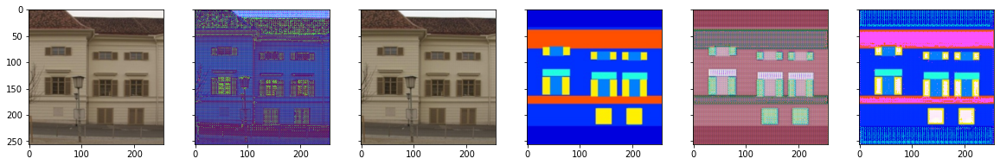

Epoch 106


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4447 gxy_loss: 2.2522 dy_loss: 0.2224 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.0135  gimage_loss 1.0165
Epoch 107


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4448 gxy_loss: 2.2158 dy_loss: 0.2225 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9968  gimage_loss 0.9968
Epoch 108


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4447 gxy_loss: 2.2630 dy_loss: 0.2224 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.0516  gimage_loss 0.9892
Epoch 109


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 2.2335 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 1.0115  gimage_loss 0.9998
Epoch 110


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4447 gxy_loss: 2.2189 dy_loss: 0.2224 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9999  gimage_loss 0.9968


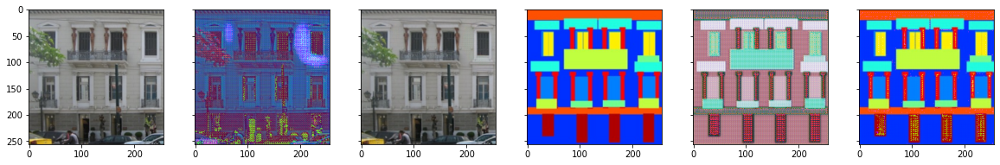

Epoch 111


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 2.1719 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9752  gimage_loss 0.9745
Epoch 112


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4447 gxy_loss: 2.1762 dy_loss: 0.2224 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9791  gimage_loss 0.9749
Epoch 113


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4447 gxy_loss: 2.1864 dy_loss: 0.2224 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9822  gimage_loss 0.9820
Epoch 114


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4447 gxy_loss: 2.1745 dy_loss: 0.2224 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9749  gimage_loss 0.9774
Epoch 115


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 2.1563 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9753  gimage_loss 0.9588


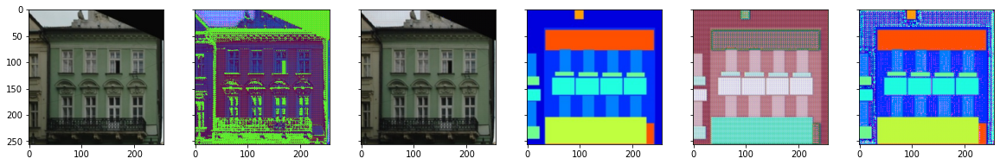

Epoch 116


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4447 gxy_loss: 2.1582 dy_loss: 0.2224 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9642  gimage_loss 0.9717
Epoch 117


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4455 gxy_loss: 2.0915 dy_loss: 0.2232 dx_loss 0.2223 gy_loss: 0.1108
gx_loss 0.1111 gmask_loss 0.9448  gimage_loss 0.9247
Epoch 118


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 2.1688 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9943  gimage_loss 0.9523
Epoch 119


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 2.1175 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9533  gimage_loss 0.9421
Epoch 120


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4447 gxy_loss: 2.1051 dy_loss: 0.2224 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9584  gimage_loss 0.9245


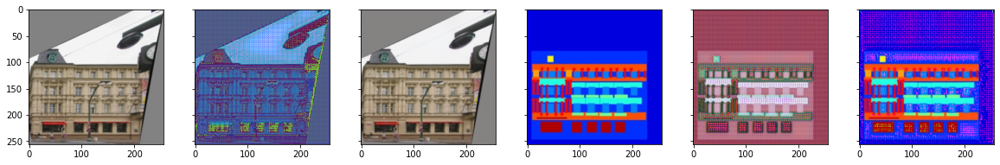

Epoch 121


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4449 gxy_loss: 2.1032 dy_loss: 0.2223 dx_loss 0.2226 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9480  gimage_loss 0.9330
Epoch 122


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 2.0845 dy_loss: 0.2224 dx_loss 0.2222 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9347  gimage_loss 0.9276
Epoch 123


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 2.0700 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9300  gimage_loss 0.9178
Epoch 124


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4447 gxy_loss: 2.0728 dy_loss: 0.2224 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9368  gimage_loss 0.9137
Epoch 125


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 2.0708 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9326  gimage_loss 0.9160


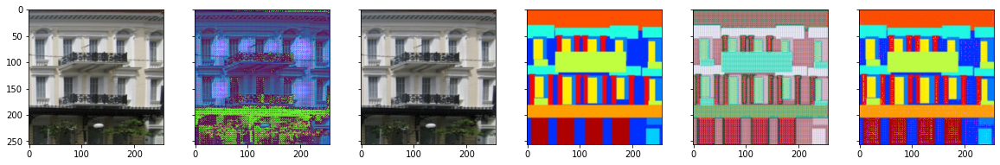

Epoch 126


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 2.0573 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9250  gimage_loss 0.9101
Epoch 127


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 2.0576 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9270  gimage_loss 0.9084
Epoch 128


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 2.0485 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9243  gimage_loss 0.9020
Epoch 129


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 2.0234 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9072  gimage_loss 0.8941
Epoch 130


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 2.0488 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9349  gimage_loss 0.8917


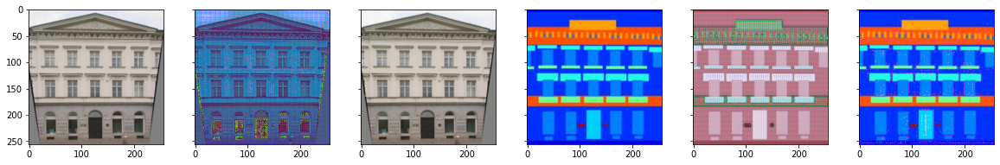

Epoch 131


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4447 gxy_loss: 2.0387 dy_loss: 0.2224 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9188  gimage_loss 0.8977
Epoch 132


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 2.0039 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9091  gimage_loss 0.8726
Epoch 133


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 1.9938 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8990  gimage_loss 0.8726
Epoch 134


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 2.0034 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9082  gimage_loss 0.8730
Epoch 135


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 2.0160 dy_loss: 0.2224 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9047  gimage_loss 0.8891


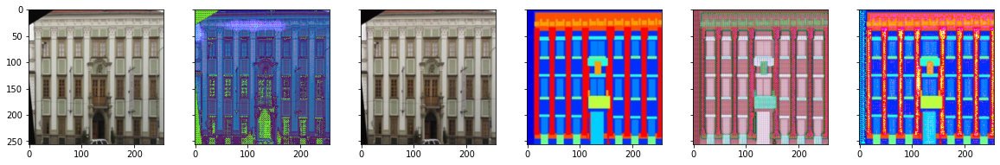

Epoch 136


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 1.9801 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8941  gimage_loss 0.8637
Epoch 137


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 1.9724 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8894  gimage_loss 0.8609
Epoch 138


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4447 gxy_loss: 1.9759 dy_loss: 0.2224 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8810  gimage_loss 0.8727
Epoch 139


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.9710 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8899  gimage_loss 0.8589
Epoch 140


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 1.9922 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9061  gimage_loss 0.8639


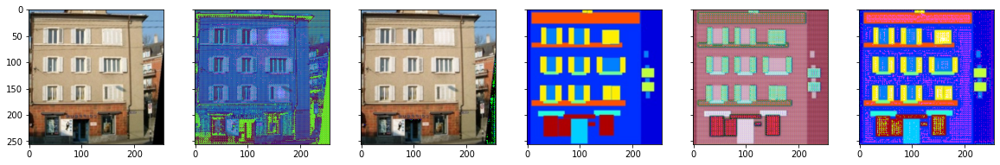

Epoch 141


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 1.9923 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9025  gimage_loss 0.8675
Epoch 142


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4450 gxy_loss: 1.9300 dy_loss: 0.2227 dx_loss 0.2223 gy_loss: 0.1110
gx_loss 0.1111 gmask_loss 0.8720  gimage_loss 0.8359
Epoch 143


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.9277 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8715  gimage_loss 0.8340
Epoch 144


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.9260 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8721  gimage_loss 0.8317
Epoch 145


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 1.8971 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8580  gimage_loss 0.8168


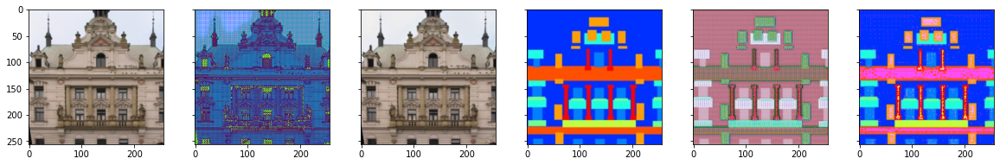

Epoch 146


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 1.9298 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8681  gimage_loss 0.8395
Epoch 147


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.9806 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9091  gimage_loss 0.8493
Epoch 148


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 1.9201 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8738  gimage_loss 0.8241
Epoch 149


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 1.8820 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8501  gimage_loss 0.8097
Epoch 150


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 1.8910 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8540  gimage_loss 0.8148


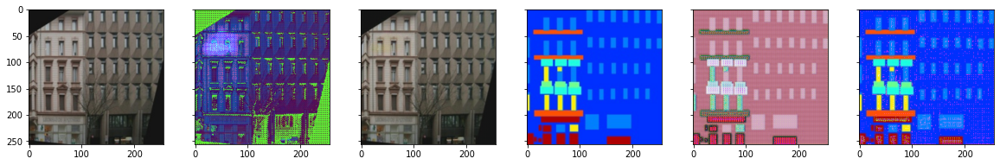

Epoch 151


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 1.8899 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8503  gimage_loss 0.8174
Epoch 152


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 1.8776 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8456  gimage_loss 0.8098
Epoch 153


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4447 gxy_loss: 1.8615 dy_loss: 0.2224 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8418  gimage_loss 0.7975
Epoch 154


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 2.0051 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.9616  gimage_loss 0.8213
Epoch 155


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.9071 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8823  gimage_loss 0.8026


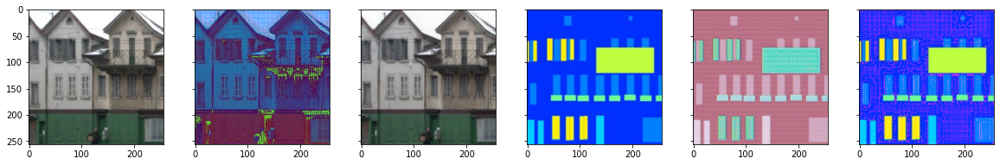

Epoch 156


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 1.8422 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8370  gimage_loss 0.7829
Epoch 157


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 1.8748 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8540  gimage_loss 0.7986
Epoch 158


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 1.8438 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8404  gimage_loss 0.7812
Epoch 159


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.8440 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8329  gimage_loss 0.7889
Epoch 160


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 1.8340 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8355  gimage_loss 0.7763


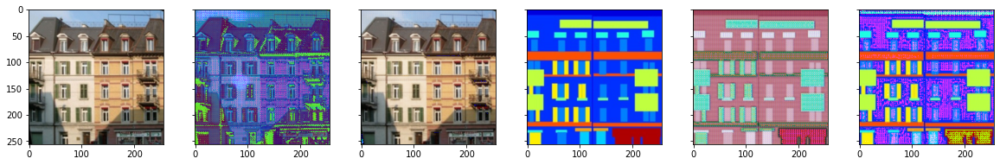

Epoch 161


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.8401 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8225  gimage_loss 0.7954
Epoch 162


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.8126 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8198  gimage_loss 0.7706
Epoch 163


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.8491 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8384  gimage_loss 0.7885
Epoch 164


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.8283 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8194  gimage_loss 0.7867
Epoch 165


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.8146 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8192  gimage_loss 0.7732


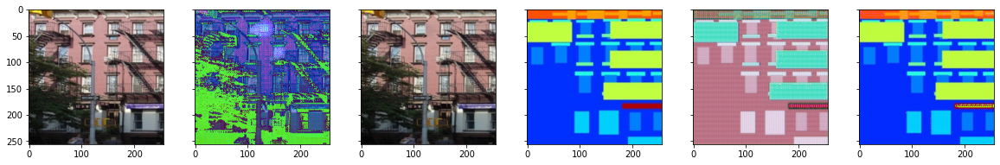

Epoch 166


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.7906 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8002  gimage_loss 0.7681
Epoch 167


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4448 gxy_loss: 1.8113 dy_loss: 0.2223 dx_loss 0.2225 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8186  gimage_loss 0.7706
Epoch 168


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.7583 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7986  gimage_loss 0.7375
Epoch 169


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.7969 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8105  gimage_loss 0.7641
Epoch 170


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 1.7678 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7946  gimage_loss 0.7509


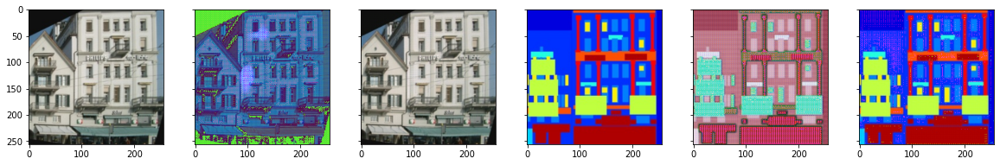

Epoch 171


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 1.7701 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8006  gimage_loss 0.7473
Epoch 172


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.7783 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8042  gimage_loss 0.7519
Epoch 173


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.7669 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7978  gimage_loss 0.7469
Epoch 174


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.7536 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7930  gimage_loss 0.7384
Epoch 175


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.7623 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7974  gimage_loss 0.7426


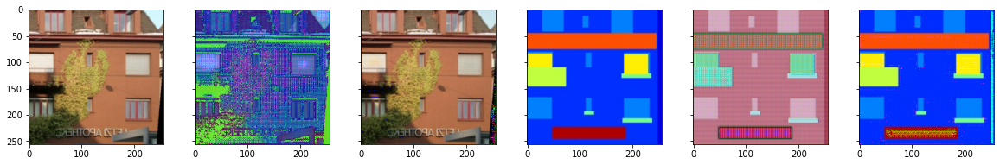

Epoch 176


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.7224 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7745  gimage_loss 0.7257
Epoch 177


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.8784 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8788  gimage_loss 0.7773
Epoch 178


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.7815 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8130  gimage_loss 0.7463
Epoch 179


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 1.7294 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7789  gimage_loss 0.7283
Epoch 180


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.8461 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8573  gimage_loss 0.7666


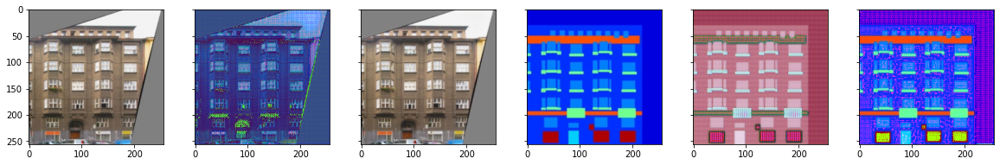

Epoch 181


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.7555 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7927  gimage_loss 0.7405
Epoch 182


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.7743 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8378  gimage_loss 0.7142
Epoch 183


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4451 gxy_loss: 1.7216 dy_loss: 0.2229 dx_loss 0.2223 gy_loss: 0.1109
gx_loss 0.1111 gmask_loss 0.7774  gimage_loss 0.7222
Epoch 184


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.7232 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7796  gimage_loss 0.7214
Epoch 185


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.6847 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7598  gimage_loss 0.7027


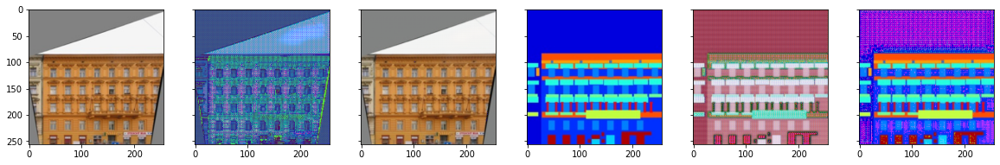

Epoch 186


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.7359 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7871  gimage_loss 0.7265
Epoch 187


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4447 gxy_loss: 1.6961 dy_loss: 0.2223 dx_loss 0.2224 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7682  gimage_loss 0.7057
Epoch 188


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.6669 dy_loss: 0.2223 dx_loss 0.2222 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7525  gimage_loss 0.6921
Epoch 189


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.7010 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7688  gimage_loss 0.7099
Epoch 190


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.6625 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7476  gimage_loss 0.6928


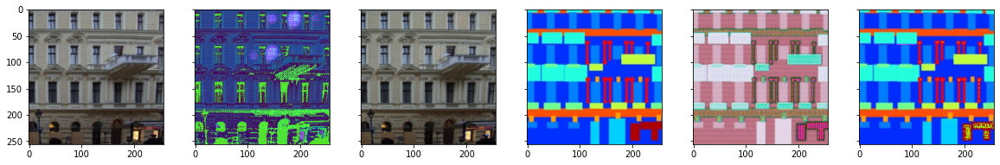

Epoch 191


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.6740 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7585  gimage_loss 0.6933
Epoch 192


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.6900 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7765  gimage_loss 0.6913
Epoch 193


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.6635 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7544  gimage_loss 0.6869
Epoch 194


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.6529 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7507  gimage_loss 0.6799
Epoch 195


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.6648 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7527  gimage_loss 0.6899


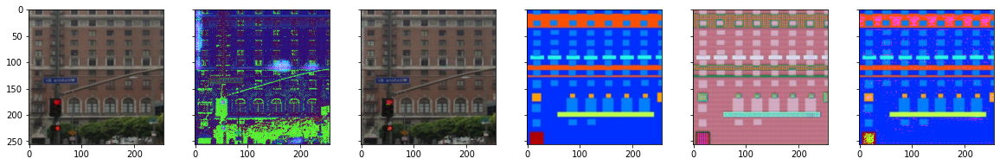

Epoch 196


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.6479 dy_loss: 0.2223 dx_loss 0.2222 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7396  gimage_loss 0.6862
Epoch 197


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4446 gxy_loss: 1.7985 dy_loss: 0.2223 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.8493  gimage_loss 0.7270
Epoch 198


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4449 gxy_loss: 1.8107 dy_loss: 0.2226 dx_loss 0.2223 gy_loss: 0.1110
gx_loss 0.1111 gmask_loss 0.8866  gimage_loss 0.7020
Epoch 199


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.6759 dy_loss: 0.2222 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7796  gimage_loss 0.6741
Epoch 200


  0%|          | 0/400 [00:00<?, ?it/s]

d_loss: 0.4445 gxy_loss: 1.6472 dy_loss: 0.2222 dx_loss 0.2223 gy_loss: 0.1111
gx_loss 0.1111 gmask_loss 0.7613  gimage_loss 0.6637


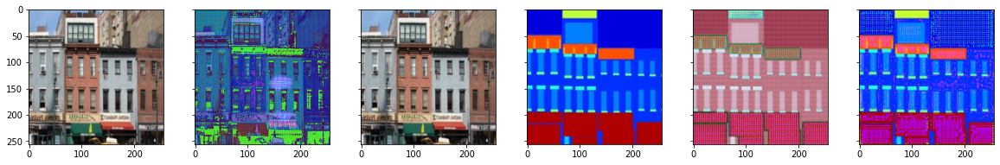

In [ ]:
num_epochs = 300

for epoch in range(num_epochs):
    print(f'Epoch {epoch + 1}')
    time.sleep(0.5)
    d_losses = []
    g_losses = []
    gxy_losses = []
    dy_losses  = []
    dx_losses  = []
    gy_losses  = []

    gx_losses = []
    gmask_losses  = []
    gimage_losses = []
    for batch in tqdm(train_dataloader):
        image, mask = batch
        #print(images.shape)
        image = image.to(device)
        mask = mask.to(device)
        
        

        # Generator loss
        optimizer_G.zero_grad()
        optimizer_DX.zero_grad()
        optimizer_DY.zero_grad()

        valid = Variable(torch.ones((image.size(0), 1, 30, 30)), requires_grad=False).to(device)
        fake = Variable(torch.zeros((image.size(0), 1, 30, 30)), requires_grad=False).to(device)


        generated_image = GXY(mask) #x->Y
        DY_generated = DY(generated_image) #Y
        cycle_mask = GYX(generated_image)
        
        generated_mask = GYX(image) #Y->X
        DX_generated = DX(generated_mask) #X
        cycle_image = GXY(generated_mask)
        

        gy_loss = torch.pow(DY_generated - valid, 2).mean() 
        gx_loss = torch.pow(DX_generated - valid, 2).mean() 
        gmask_loss = l1_lambda * F.l1_loss(cycle_mask, mask) 
        gimage_loss = l1_lambda *  F.l1_loss(cycle_image, image)

        gxy_loss = gy_loss + gx_loss + gmask_loss + gimage_loss
        gxy_loss.backward()
        optimizer_G.step()
        
     
        real_loss_Y = torch.pow(DY(image) - valid, 2).mean()
        fake_loss_Y = torch.pow(DY(generated_image.detach()), 2).mean() 
        dy_loss = (real_loss_Y + fake_loss_Y) / 2


        real_loss_X = torch.pow(DX(mask) - valid, 2).mean()
        fake_loss_X = torch.pow(DX(generated_mask.detach()), 2).mean() 
        dx_loss = (real_loss_X + fake_loss_X) / 2
        d_loss = dx_loss + dy_loss

        dy_loss.backward()
        dx_loss.backward()
        optimizer_DX.step()
        optimizer_DY.step()
        
        d_losses.append(d_loss.item())
        gxy_losses.append(gxy_loss.item())

        dy_losses.append(dy_loss.item())
        dx_losses.append(dx_loss.item())
        gy_losses.append(gy_loss.item())
        gx_losses.append(gx_loss.item())
        gmask_losses.append(gmask_loss.item())
        gimage_losses.append(gimage_loss.item())
        
    print(f'd_loss: {np.mean(d_losses):0.4f} gxy_loss: {np.mean(gxy_losses):0.4f} dy_loss: {np.mean(dy_losses):0.4f} dx_loss {np.mean(dx_losses):0.4f} gy_loss: {np.mean(gy_losses):0.4f}')
    print(f'gx_loss {np.mean(gx_losses):0.4f} gmask_loss {np.mean(gmask_losses):0.4f}  gimage_loss {np.mean(gimage_losses):0.4f}')
    if (epoch + 1) % 5 == 0:
        plot_images_cycle(image, mask, generated_image.detach(), generated_mask.detach(), cycle_image.detach(), cycle_mask.detach())
  

In [ ]:
test_dataset1 = Dataset('./facades/test', split = 'test')
test_dataloader1 = data.DataLoader(test_dataset1, batch_size=4, shuffle=True, num_workers=2)
dataiter = iter(test_dataloader1)
GXY.eval()

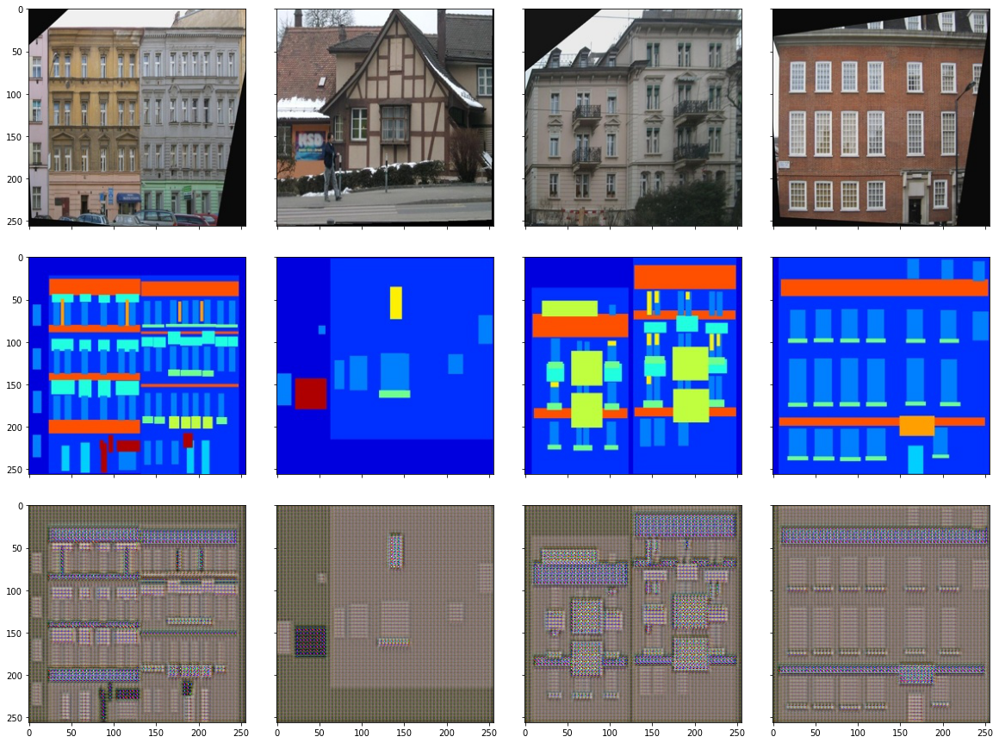

In [ ]:
batch = next(dataiter)
images, masks = batch
images = images.to(device)
masks = masks.to(device)
with torch.no_grad():
    generated = GXY(masks)

plot_images(images, masks, generated)